Running Avail Fusion simulation for 365 days...
###########################
timestep 0
[DEBUG] update_token_prices
{'avl_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=1.0, balance=9000000.0, price=0.1), 'ETH': AssetAllocation(pct=0.0, balance=0, price=1500.0), 'BTC': AssetAllocation(pct=0.0, balance=0, price=85000.0)}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1), 'eth_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=0.0, balance=0, price=0.1), 'ETH': AssetAllocation(pct=1.0, balance=300, price=1500.0), 'BTC': AssetAllocation(pct=0.0, balance=0, price=85000.0)}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1), 'btc_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=0.0, balance=0, price=0.1), 'ETH': AssetAllocation(pct=0.0, balance=0, price=1500.0), 'BTC': AssetAllocation(pct=0.0, balance=0, price=85000.0)}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1)}
  AVL Flow: $33,314.00 (D: $238,770.33, W: $205,456.33)
  ETH

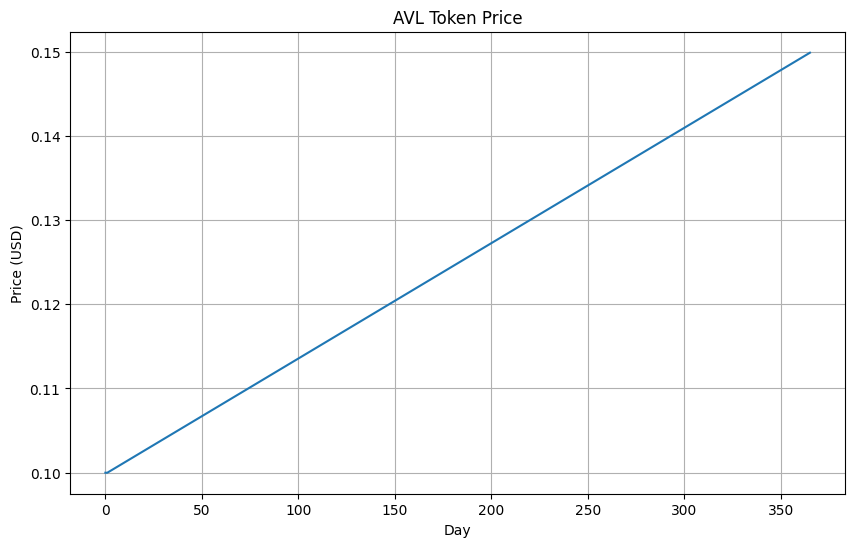

In [1]:
import scripts.simulation_runner as sim
import visualizations.comparison_plots as comp_plots


# Run a simulation with default parameters
results = sim.run_simulation()

# Visualize results
sim.plot_simulation_results(results)

<class 'float'>
<class 'float'>
<class 'float'>
<class 'float'>
Running Avail Fusion simulation for 365 days...
###########################
timestep 0
[DEBUG] update_token_prices
{'avl_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=1.0, balance=9000000.0, price=0.01), 'ETH': AssetAllocation(pct=0.0, balance=0, price=1440.9005589074684), 'BTC': AssetAllocation(pct=0.0, balance=0, price=81808.15201471717)}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1), 'eth_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=0.0, balance=0, price=0.01), 'ETH': AssetAllocation(pct=1.0, balance=300, price=1440.9005589074684), 'BTC': AssetAllocation(pct=0.0, balance=0, price=81808.15201471717)}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1), 'btc_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=0.0, balance=0, price=0.01), 'ETH': AssetAllocation(pct=0.0, balance=0, price=1440.9005589074684), 'BTC': AssetAllocation(pct=0.0, balance=0, price=81808.1520147171

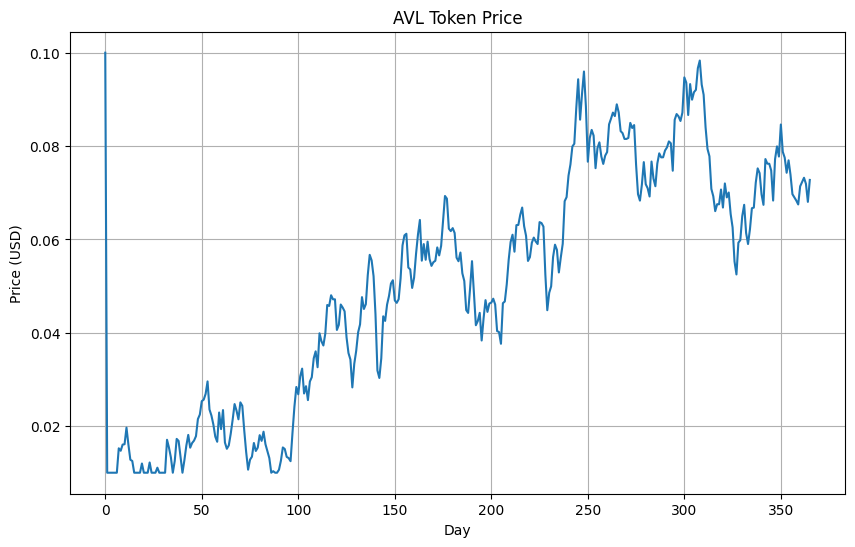

In [2]:
# Create a configuration using Brownian Motion for all assets
config = sim.SimulationConfig(
    # Basic simulation parameters
    simulation_days=365,
    
    # Initial prices
    avl_initial_price=0.05,
    eth_initial_price=1500,
    btc_initial_price=85000,
    lens_initial_price=1.0,
    
    # Use Brownian Motion price process
    price_process_type='BM',
    
    # AVL Brownian Motion parameters
    price_traj_type='convex',      # 'convex', 'concave', or 'none'
    minimum_price=0.01,            # Minimum possible price
    maximum_price=0.5,             # Maximum possible price
    target_avg_price=0.05,          # Target average price across simulation
    bm_volatility=1.2,             # Controls randomness (higher = more volatile)
    
    # ETH Brownian Motion parameters
    eth_price_traj_type='convex', # Different trend type for ETH
    eth_minimum_price=1200,        # ETH-specific price floor
    eth_maximum_price=2500,        # ETH-specific price ceiling
    eth_target_avg_price=1600,     # Target average ETH price
    eth_bm_volatility=0.8,         # Lower volatility for ETH
    
    # BTC Brownian Motion parameters
    btc_price_traj_type='convex',    # Pure random walk for BTC
    btc_minimum_price=70000,       # BTC-specific price floor
    btc_maximum_price=100000,      # BTC-specific price ceiling  
    btc_target_avg_price=85000,    # Target average BTC price
    btc_bm_volatility=0.6,         # Even lower volatility for BTC
    
    # LENS Brownian Motion parameters (optional)
    lens_price_traj_type='convex',
    lens_minimum_price=0.8,
    lens_maximum_price=1.5,
    lens_target_avg_price=1.1,
    lens_bm_volatility=1.0,
    
    # Other parameters
    restaking=1.0
)

# Run simulation with Brownian Motion price model for all assets
results = sim.run_simulation(config)
sim.plot_simulation_results(results)

In [3]:
# Base configuration
base_config = sim.SimulationConfig(restaking=1.0, avl_price_growth=-0.9)

# Define comparison configurations
comparisons = [
    {'restaking': 1.0, "avl_price_growth":-0.7},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":-0.5},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":-0.3},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":-0.1},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":0.0},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":0.1},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":0.3},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":0.5},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":0.7},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":0.9},   # 100% restaking
]

# Run comparisons
results = sim.compare_simulations(
    base_config=base_config,
    comparison_configs=comparisons,
    names=["Down 90%", "Down 70%", "Down 50%", "Down 30%", "Down 10%", "No change", "Up 10%", "Up 30%", "Up 50%", "Up 70%", "Up 90%"],
)

# Access individual results
for name, df in results.items():
    print(f"Results for {name}:")

Running Down 90% (base simulation)...
Running Avail Fusion simulation for 365 days...
###########################
timestep 0
[DEBUG] update_token_prices
{'avl_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=1.0, balance=9000000.0, price=0.1), 'ETH': AssetAllocation(pct=0.0, balance=0, price=1500.0), 'BTC': AssetAllocation(pct=0.0, balance=0, price=85000.0)}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1), 'eth_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=0.0, balance=0, price=0.1), 'ETH': AssetAllocation(pct=1.0, balance=300, price=1500.0), 'BTC': AssetAllocation(pct=0.0, balance=0, price=85000.0)}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1), 'btc_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=0.0, balance=0, price=0.1), 'ETH': AssetAllocation(pct=0.0, balance=0, price=1500.0), 'BTC': AssetAllocation(pct=0.0, balance=0, price=85000.0)}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1)}
  AVL Flow: $33,314.00 

In [4]:
len(results)

11

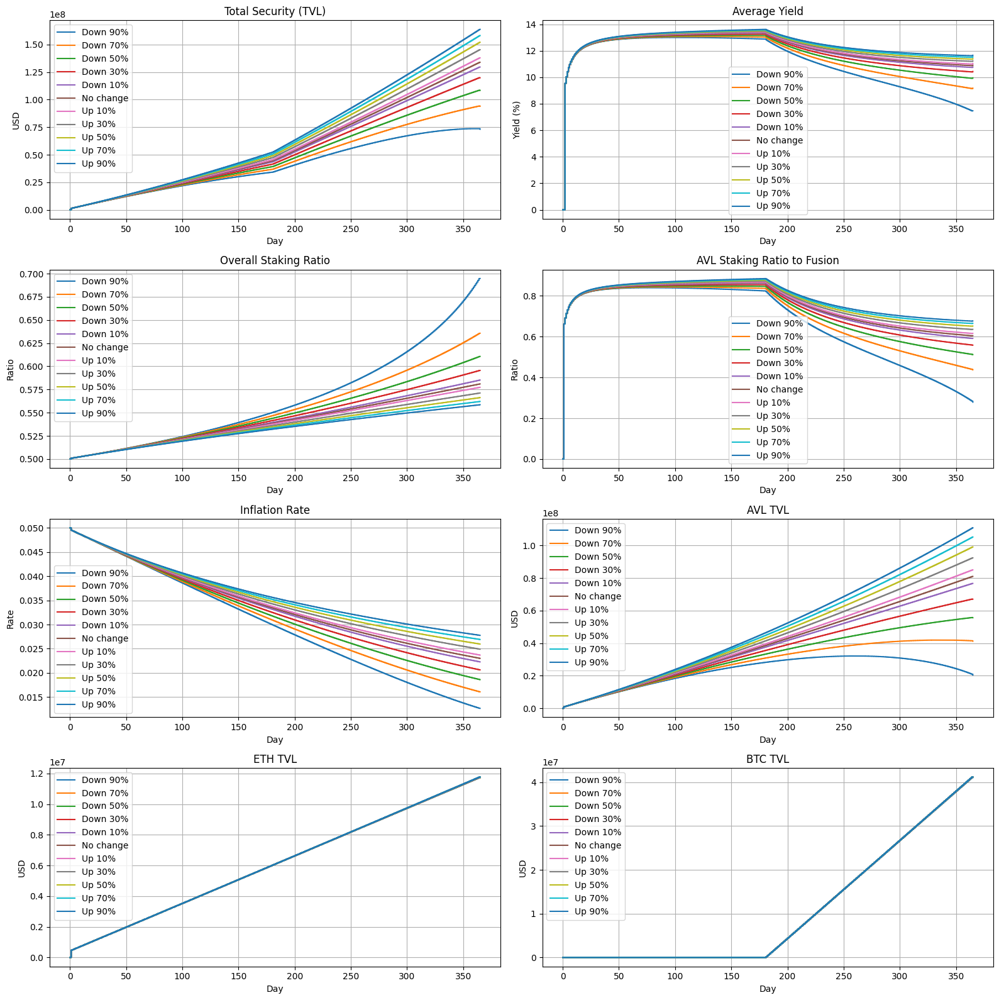

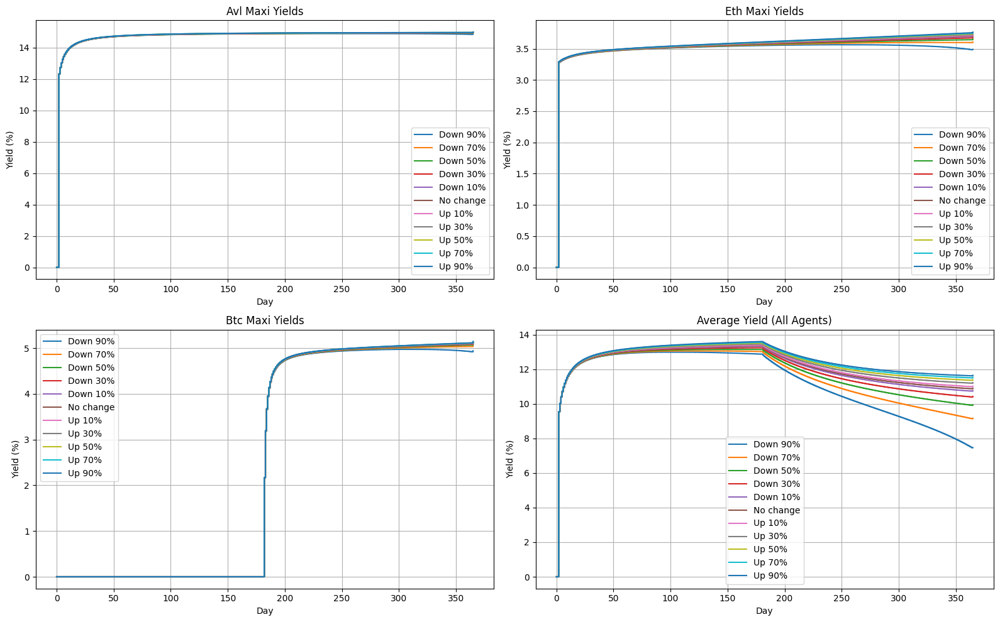

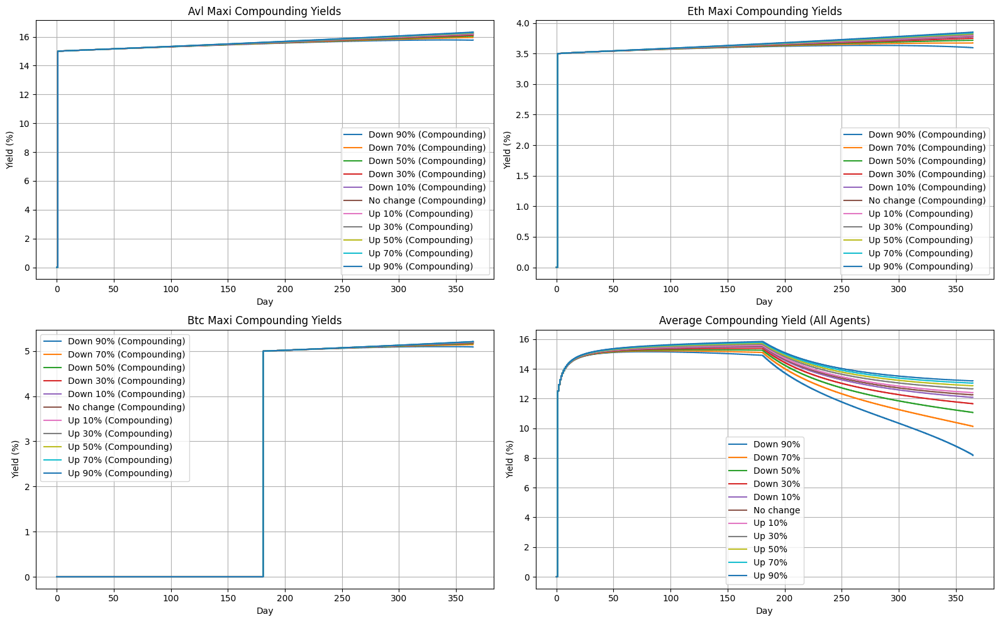

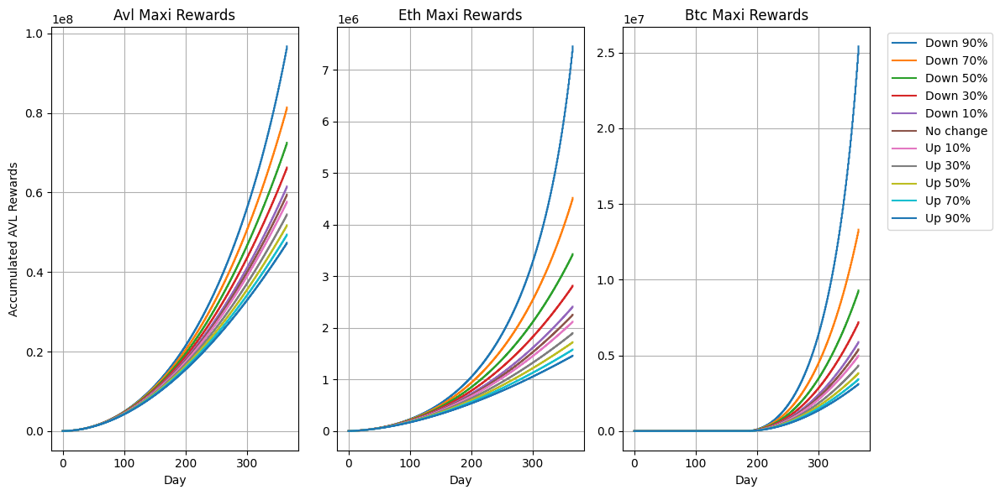

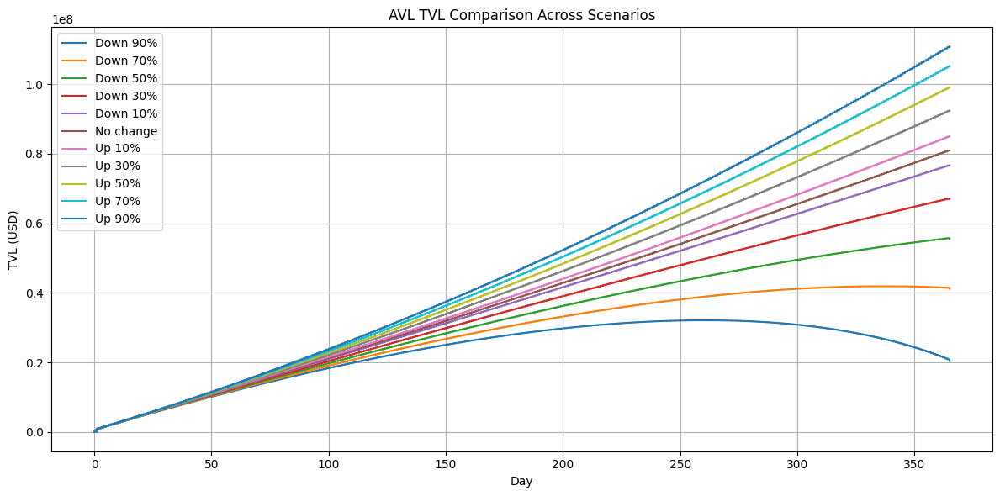

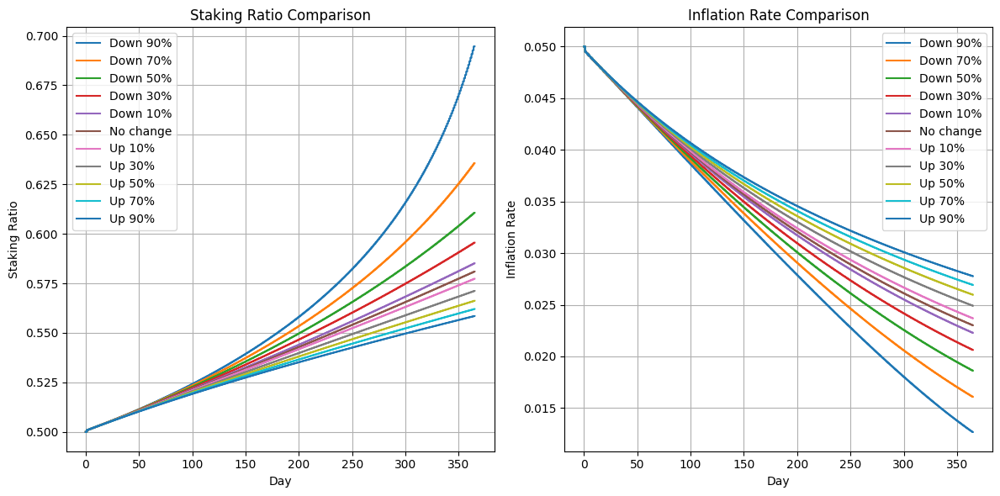

In [ ]:


# Create a comprehensive dashboard comparing all scenarios
comp_plots.plot_comparison_dashboard(results)

# Compare yields across scenarios
comp_plots.plot_yields_comparison(results)

# Compare accumulated rewards
comp_plots.plot_rewards_comparison(results)

In [6]:
# Base configuration
base_config = sim.SimulationConfig(restaking=1.0, avl_price_growth=-0.9)

# Define comparison configurations
comparisons = [
    {'restaking': 0, "avl_price_growth":-0.9},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":-0.5},   # 100% restaking
    {'restaking': 0, "avl_price_growth":-0.5},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":-0.1},   # 100% restaking
    {'restaking': 0, "avl_price_growth":-0.1},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":0.1},   # 100% restaking
    {'restaking': 0, "avl_price_growth":0.1},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":0.5},   # 100% restaking
    {'restaking': 0, "avl_price_growth":0.5},   # 100% restaking
    {'restaking': 1.0, "avl_price_growth":0.9},   # 100% restaking
    {'restaking': 0, "avl_price_growth":0.9},   # 100% restaking
]

# Run comparisons
results = sim.compare_simulations(
    base_config=base_config,
    comparison_configs=comparisons,
    names=["Restake, Down 90%", "Unrestake, Down 90%", 
           "Restake, Down 50%", "Unrestake, Down 50%", 
           "Restake, Down 10%", "Unrestake, Down 10%", 
           "Restake, Up 10%", "Unrestake, Up 10%", 
           "Restake, Up 50%", "Unrestake, Up 50%",
           "Restake, Up 90%", "Unrestake, Up 90%"],
)

# Access individual results
for name, df in results.items():
    print(f"Results for {name}:")

Running Restake, Down 90% (base simulation)...
Running Avail Fusion simulation for 365 days...
###########################
timestep 0
[DEBUG] update_token_prices
{'avl_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=1.0, balance=9000000.0, price=0.1), 'ETH': AssetAllocation(pct=0.0, balance=0, price=1500.0), 'BTC': AssetAllocation(pct=0.0, balance=0, price=85000.0)}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1), 'eth_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=0.0, balance=0, price=0.1), 'ETH': AssetAllocation(pct=1.0, balance=300, price=1500.0), 'BTC': AssetAllocation(pct=0.0, balance=0, price=85000.0)}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1), 'btc_maxi': AgentStake(assets={'AVL': AssetAllocation(pct=0.0, balance=0, price=0.1), 'ETH': AssetAllocation(pct=0.0, balance=0, price=1500.0), 'BTC': AssetAllocation(pct=0.0, balance=0, price=85000.0)}, curr_annual_rewards_avl=0.0, accu_rewards_avl=0.0, restake_pct=1)}
  AVL Flow: $3